In [1]:
import os
from datetime import datetime
import numpy as np
import glob
from satpy import Scene
import subprocess

import pyresample
from pyresample import geo_filter, geometry, load_area
import shapely.geometry as sgeom

import cartopy.crs as ccrs
import pandas as pd

import PIL

import matplotlib.pyplot as plt

In [2]:
SAT_IMAGERY_PATH = '/storage/data/eumetsat/native/sorted'
TEMP_PATH = '/home/jack/temp'

In [149]:
def get_directory_for_datetime(sat_imagery_path: str, dt: datetime) -> str:
    """
    Args:
        sat_imagery_path:
        dt: the datetime for the requested image.  Will return
            the directory which is within 5 minutes of the requested image.
    Returns:
        Directory string
        
    Raises:
        FileNotFoundError
    """
    hour_path = dt.strftime("%Y/%m/%d/%H")
    hour_path = os.path.join(SAT_IMAGERY_PATH, hour_path)
    
    # Get a list of subdirectories containing minutes
    _, minute_dirs, _ = next(os.walk(hour_path))
    minutes_with_images = np.array(minute_dirs, dtype=int)
    
    # Quantize dt.minute to 5-minute intervals
    minute_lower_bound = (dt.minute // 5) * 5
    minute_upper_bound = minute_lower_bound + 5
    
    # Find matching directory for the minutes
    selection_condition = (
        (minute_lower_bound <= minutes_with_images) & 
        (minutes_with_images < minute_upper_bound))
    idx = np.flatnonzero(selection_condition)
    
    # Sanity check
    if idx.size == 0:
        raise FileNotFoundError(2, 'No minute directory for datetime {} under "{}"'.format(dt, hour_path))
    elif idx.size > 1:
        raise RuntimeError(
            'Found > 1 directories with images for datetime {}.'
            '  Base dir = "{}".  Subdirs found = {}'
            .format(dt, hour_path, minute_dirs))
        
    selected_minute_dir = minutes_with_images[idx[0]]
    selected_minute_dir = '{:02d}'.format(selected_minute_dir)
    selected_minute_dir = os.path.join(hour_path, selected_minute_dir)
    
    return selected_minute_dir

dt = datetime(year=2019, month=1, day=25, hour=13, minute=0)  # 2019-01-22 10:00 is fairly good for UK
image_path = get_directory_for_datetime(SAT_IMAGERY_PATH, dt)
image_path

'/storage/data/eumetsat/native/sorted/2019/01/25/13/04'

In [150]:
def get_image_filename_for_datetime(
    sat_imagery_path: str, 
    dt: datetime,
    pattern: str = 'MSG*.nat.bz2'
    ) -> str:
    
    image_path = get_directory_for_datetime(sat_imagery_path, dt)
    files = glob.glob(os.path.join(image_path, pattern))
    error_str = 'file matching "{}" in "{}" for datetime {}.'.format(pattern, image_path, dt)
    if len(files) == 0:
        raise FileNotFoundError(2, 'No ' + error_str)
    if len(files) > 1:
        raise RuntimeError('Found > 1 ' + error_str + '  Expected only one match.')
    image_filename = files[0]
    return image_filename

full_bzip_filename = get_image_filename_for_datetime(SAT_IMAGERY_PATH, dt)
full_bzip_filename

'/storage/data/eumetsat/native/sorted/2019/01/25/13/04/MSG3-SEVI-MSG15-0100-NA-20190125130416.429000000Z-20190125130435-1354464-5.nat.bz2'

In [151]:
def decompress(full_bzip_filename: str) -> str:
    base_bzip_filename = os.path.basename(full_bzip_filename)
    base_nat_filename = os.path.splitext(base_bzip_filename)[0]
    full_nat_filename = os.path.join(TEMP_PATH, base_nat_filename)
    if not os.path.exists(full_nat_filename):
        with open(full_nat_filename, 'wb') as nat_file_handler:
            process = subprocess.run(
                ['pbzip2', '--decompress', '--keep', '--stdout', full_bzip_filename],
                stdout=nat_file_handler)
        process.check_returncode()
    return full_nat_filename

    
full_nat_filename = decompress(full_bzip_filename)

In [152]:
full_nat_filename

'/home/jack/temp/MSG3-SEVI-MSG15-0100-NA-20190125130416.429000000Z-20190125130435-1354464-5.nat'

In [153]:
scene = Scene(
    filenames=[full_nat_filename],
    reader='seviri_l1b_native')

CPU times: user 196 ms, sys: 8.35 ms, total: 204 ms
Wall time: 202 ms


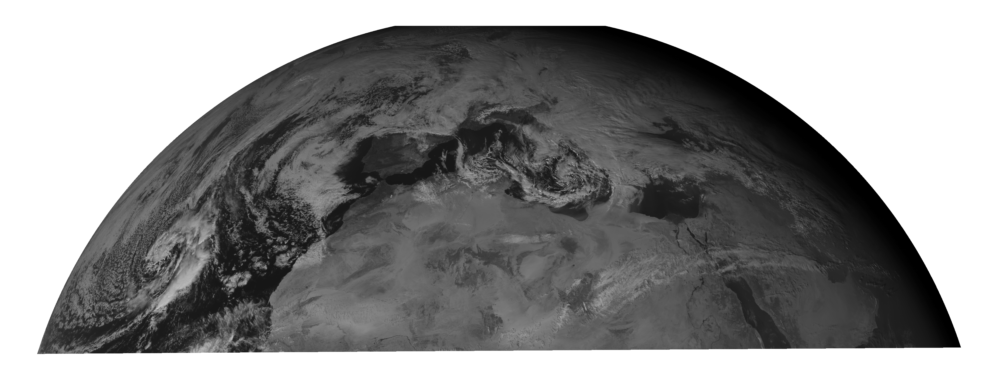

In [154]:
%%time
scene.load(['VIS006'])
scene.show('VIS006')

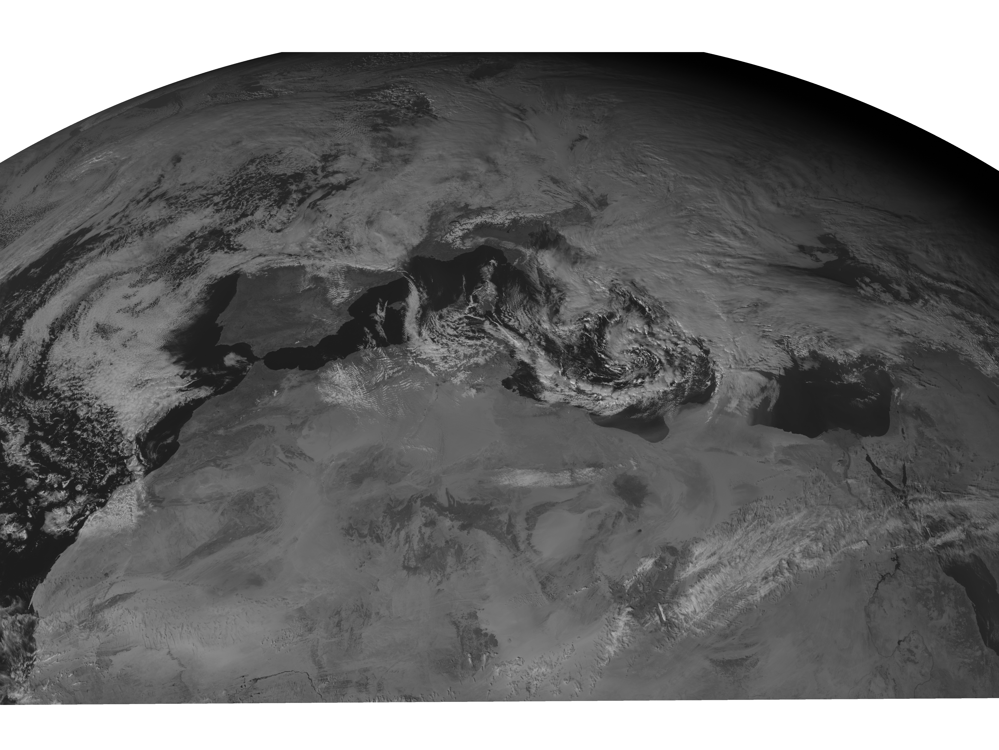

In [155]:
scene.load(['HRV'])
scene.show('HRV')

In [156]:
#hrv_lonlats = scene['HRV'].area.get_lonlats()
#vis_lonlats = scene['VIS006'].area.get_lonlats()

In [157]:
# np.testing.assert_almost_equal(hrv_lonlats[0], vis_lonlats[0])

In [158]:
scene['VIS006']

<xarray.DataArray 'getitem-8c1aaf29ec2931e87455a6f6fc9bccc2' (y: 1392, x: 3712)>
dask.array<truediv, shape=(1392, 3712), dtype=float32, chunksize=(1392, 3712), chunktype=numpy.ndarray>
Coordinates:
    crs      object +proj=geos +a=6378169.0 +b=6356583.800000001 +lon_0=9.5 +h=35785831.0 +units=m +type=crs
  * x        (x) float64 -5.569e+06 -5.566e+06 ... 5.563e+06 5.566e+06
  * y        (y) float64 5.569e+06 5.566e+06 5.563e+06 ... 1.398e+06 1.395e+06
Attributes:
    orbital_parameters:   {'projection_longitude': 9.5, 'projection_latitude'...
    units:                %
    platform_name:        Meteosat-10
    standard_name:        toa_bidirectional_reflectance
    sensor:               seviri
    wavelength:           (0.56, 0.635, 0.71)
    start_time:           2019-01-25 13:00:09.872074
    end_time:             2019-01-25 13:05:09.943574
    area:                 Area ID: some_area_name\nDescription: On-the-fly ar...
    name:                 VIS006
    resolution:           300

In [159]:
scene['HRV'].crs

<xarray.DataArray 'crs' ()>
array(<Projected CRS: +proj=geos +a=6378169.0 +b=6356583.800000001 +lon_ ...>
Name: unknown
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unknown
- method: Geostationary Satellite (Sweep Y)
Datum: unknown
- Ellipsoid: unknown
- Prime Meridian: Greenwich
, dtype=object)
Coordinates:
    crs      object +proj=geos +a=6378169.0 +b=6356583.800000001 +lon_0=9.5 +h=35785831.0 +units=m +type=crs

The distance between spacecraft and centre of earth is 42164 km. The idealized earthis a perfect ellipsoid with an equator radius of 6378.1690 km and a polar radius of 6356.5838 km.

In [31]:
scene['VIS006'].crs == scene['HRV'].crs

<xarray.DataArray 'crs' ()>
array(True)
Coordinates:
    crs      object +proj=geos +a=6378169.0 +b=6356583.800000001 +lon_0=9.5 +h=35785831.0 +units=m +type=crs

## UKV

In [15]:
KM_TO_M = 1000

NORTH = 1223 * KM_TO_M
SOUTH = -185 * KM_TO_M
WEST = -239 * KM_TO_M
EAST = 857 * KM_TO_M

class UKVDomain(ccrs.OSGB):
    """The geographical domain of the UK Met Office UKV model."""
    
    @property
    def x_limits(self):
        return (WEST, EAST)
    
    @property
    def y_limits(self):
        return (SOUTH, NORTH)
    
    @property
    def boundary(self):
        return sgeom.LineString([
            (WEST, SOUTH), 
            (WEST, NORTH), 
            (EAST, NORTH), 
            (EAST, SOUTH), 
            (WEST, SOUTH)])
    
ukv = UKVDomain()
ukv

In [16]:
area_extent = [
        WEST,# - 1500000, # lower_left_x
        SOUTH, # lower_left_y
        EAST,# - 500000,  # upper_right_x
        NORTH,# + 500000] # upper_right_y
]

proj4_params = ukv.proj4_params

ukv_geom = geometry.AreaDefinition(
    area_id='UKV',
    description='Europe (3km, HRV, VTC)',
    proj_id='UKV',
    projection=proj4_params,
    width=700,  # in number of pixels
    height=500, # in number of pixels
    area_extent=area_extent,
    nprocs=8
)

ukv_geom

Area ID: UKV
Description: Europe (3km, HRV, VTC)
Projection ID: UKV
Projection: {'ellps': 'airy', 'k': '0.9996012717', 'lat_0': '49', 'lon_0': '-2', 'no_defs': 'None', 'proj': 'tmerc', 'type': 'crs', 'units': 'm', 'x_0': '400000', 'y_0': '-100000'}
Number of columns: 700
Number of rows: 500
Area extent: (-239000, -185000, 857000, 1223000)

In [17]:
ukv_geom.to_cartopy_crs()

_PROJ4Projection(+ellps=airy +proj=tmerc +lat_0=49.0 +lon_0=-2.0 +k=0.9996012717 +x_0=400000.0 +y_0=-100000.0 +units=m +no_defs=True +no_defs)

## Europe

In [18]:
europe = geometry.AreaDefinition(
    area_id='areaD',
    description='Europe (3km, HRV, VTC)',
    proj_id='areaD',
    projection={  # Proj.4 parameters
     'lat_0': '90.0',
     'lat_ts': '60.00',
     'lon_0': '0.00',
     'ellps': 'WGS84',
     'proj': 'stere'},
    width=500,  # in number of pixels
    height=500, # in number of pixels
    area_extent=[
        -3780000.0, # lower_left_x
        -7644000.0, # lower_left_y
        3900000.0,  # upper_right_x
        -1500000.0], # upper_right_y
    nprocs=8
)

In [19]:
europe

Area ID: areaD
Description: Europe (3km, HRV, VTC)
Projection ID: areaD
Projection: {'ellps': 'WGS84', 'lat_0': '90', 'lat_ts': '60', 'lon_0': '0', 'no_defs': 'None', 'proj': 'stere', 'type': 'crs', 'units': 'm', 'x_0': '0', 'y_0': '0'}
Number of columns: 500
Number of rows: 500
Area extent: (-3780000.0, -7644000.0, 3900000.0, -1500000.0)

In [20]:
europe.to_cartopy_crs()

_PROJ4Projection(+ellps=WGS84 +lat_0=90.0 +lat_ts=60.0 +lon_0=0.0 +no_defs=True +proj=stere +type=crs +units=m +x_0=0.0 +y_0=0.0 +no_defs)

## Satpy Resample

In [21]:
%%time

destination = europe  # or ukv_geom

# TODO why isn't it respecting nprocs?
resampled = scene.resample(
    destination,
    datasets=['VIS006'], 
    #nprocs=8
)

/home/jack/miniconda3/envs/sat_image_processing/lib/python3.7/site-packages/pyresample/spherical.py:123: RuntimeWarning: invalid value encountered in true_divide
  self.cart /= np.sqrt(np.einsum('...i, ...i', self.cart, self.cart))


CPU times: user 588 ms, sys: 204 ms, total: 791 ms
Wall time: 813 ms


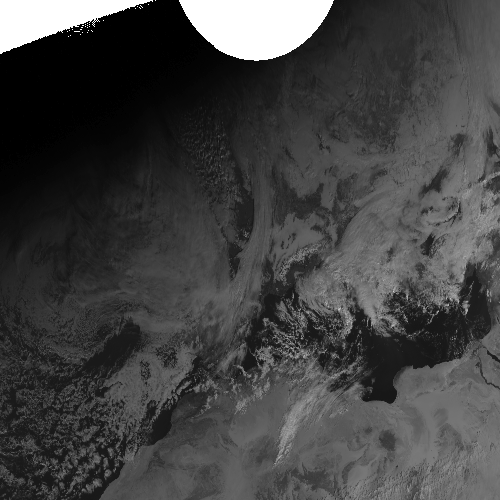

In [22]:
resampled.show('VIS006')

In [23]:
destination.area_extent

(-3780000.0, -7644000.0, 3900000.0, -1500000.0)

/home/jack/miniconda3/envs/sat_image_processing/lib/python3.7/site-packages/cartopy/mpl/geoaxes.py:838: UserWarning: Attempting to set identical left == right == -3780000.0 results in singular transformations; automatically expanding.
  min(bounds[1], self.projection.x_limits[1]))
/home/jack/miniconda3/envs/sat_image_processing/lib/python3.7/site-packages/cartopy/mpl/geoaxes.py:842: UserWarning: Attempting to set identical bottom == top == -1500000.0 results in singular transformations; automatically expanding.
  min(bounds[1], self.projection.y_limits[1]))


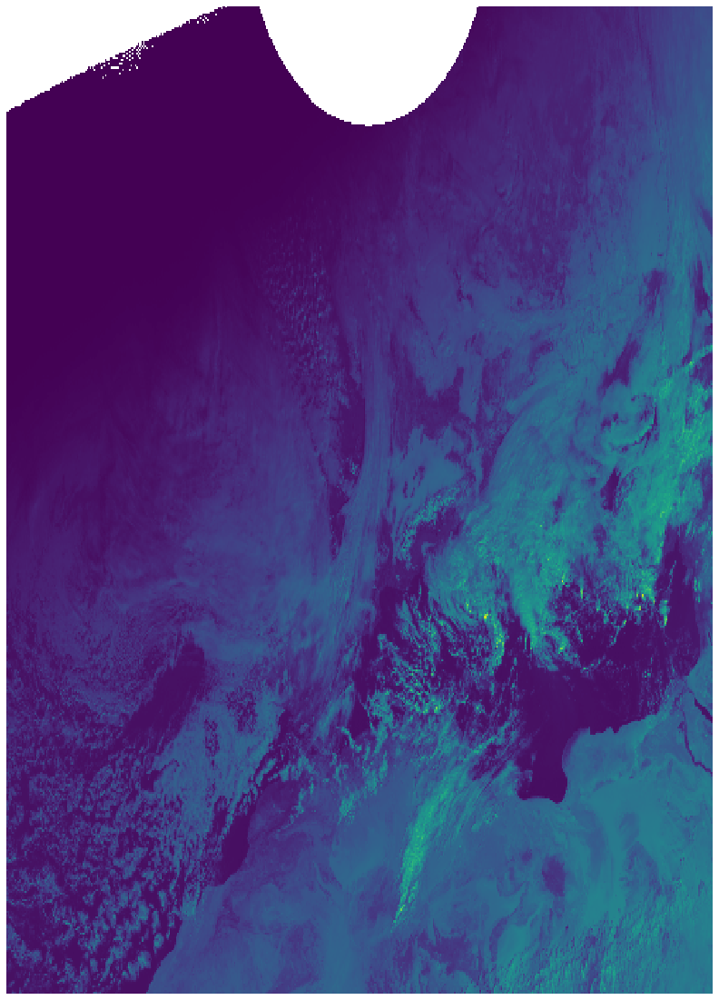

In [25]:
crs = destination.to_cartopy_crs()
fig = plt.figure(figsize=(20, 20))
ax = plt.axes(projection=crs)
ax.coastlines(resolution='50m', alpha=0.9)
#resampled.show('HRV')
ax.imshow(resampled['VIS006'].values, origin='upper', extent=destination.area_extent)

## Pyresample

In [131]:
hrv = scene['HRV'].values
hrv.shape

(4176, 5568)

In [132]:
scene['VIS006'].values.shape

(1392, 3712)

The EUMETSAT docs say "The distance between spacecraft and centre of earth is 42,164 km. The idealized earthis a perfect ellipsoid with an equator radius of 6378.1690 km and a polar radius of 6356.5838 km."  But SayPy uses 35,785 km as the height.  This seems to work well though.

In [164]:
X_OFFSET = 55000

seviri = geometry.AreaDefinition(
    area_id='seviri',
    description='SEVIRI RSS',
    proj_id='seviri',   
    projection={
         'proj': 'geos',
         'lon_0': 9.5,
         'a': 6378169.0,
         'b': 6356583.8,
         'h': 35785831.00,  # 42164000
         'units': 'm'},
    width=hrv.shape[1],
    height=hrv.shape[0],
    area_extent=[
        -2768872.0236 + X_OFFSET, # left
         1394687.3892 + TOP_OFFSET, # bottom
         2799876.1893 + X_OFFSET, # right
         5571248.5489 - TOP_OFFSET ] # top
)

seviri

Area ID: seviri
Description: SEVIRI RSS
Projection ID: seviri
Projection: {'a': '6378169', 'b': '6356583.8', 'h': '35785831', 'lon_0': '9.5', 'no_defs': 'None', 'proj': 'geos', 'type': 'crs', 'units': 'm', 'x_0': '0', 'y_0': '0'}
Number of columns: 5568
Number of rows: 4176
Area extent: (-2713872.0236, 1394687.3892, 2854876.1893, 5571248.5489)

In [165]:
crs = seviri.to_cartopy_crs()
crs

_PROJ4Projection(+ellps=WGS84 +a=6378169.0 +b=6356583.8 +h=35785831.0 +lon_0=9.5 +no_defs=True +proj=geos +type=crs +units=m +x_0=0.0 +y_0=0.0 +no_defs)

In [166]:
crs.bounds

(-2713872.0236, 2854876.1893, 1394687.3892, 5571248.5489)

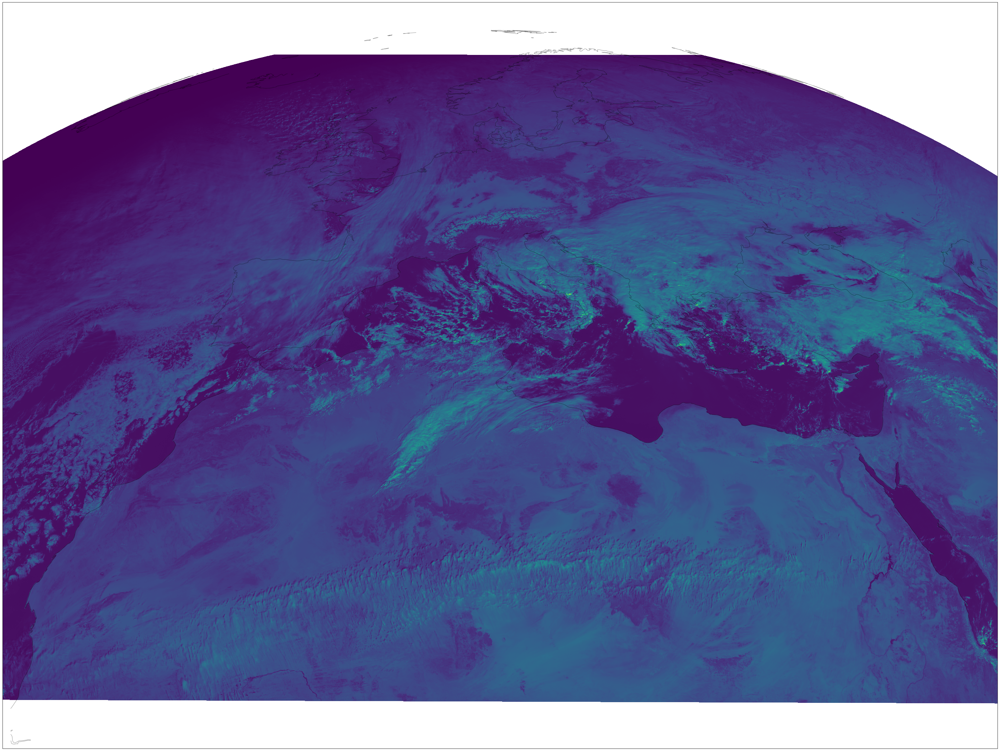

In [167]:
fig = plt.figure(figsize=(50, 40))
ax = plt.axes(projection=crs)
ax.coastlines(resolution='50m', alpha=0.4)
ax.imshow(
    hrv,
    extent=crs.bounds,
    origin='upper')

In [187]:
%%time

destination = ukv_geom

seviri_image = pyresample.image.ImageContainerQuick(
    hrv, #[::-1, ::-1], 
    seviri, 
    nprocs=1
)

resampled = seviri_image.resample(destination)

CPU times: user 195 ms, sys: 0 ns, total: 195 ms
Wall time: 193 ms


In [188]:
#fig, ax = plt.subplots(figsize=(20, 20))
#ax.imshow(hrv)

/home/jack/miniconda3/envs/sat_image_processing/lib/python3.7/site-packages/cartopy/io/__init__.py:260: DownloadWarning: Downloading: http://naciscdn.org/naturalearth/10m/physical/ne_10m_coastline.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)


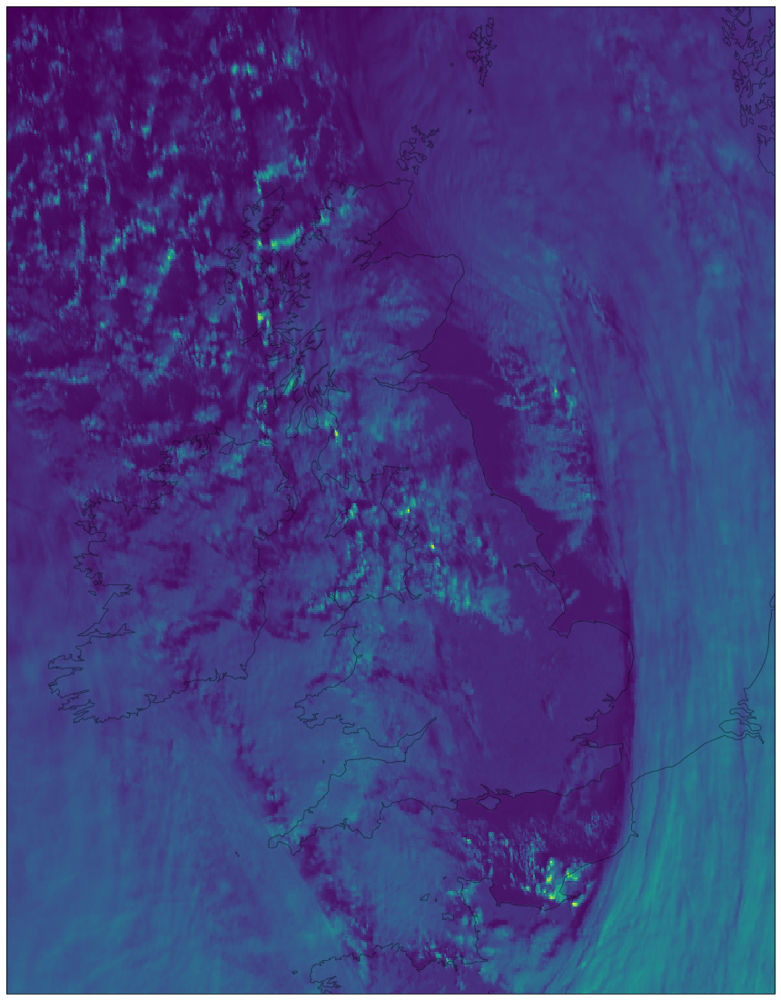

In [191]:
crs = destination.to_cartopy_crs()
fig = plt.figure(figsize=(20, 20))
ax = plt.axes(projection=crs)
ax.coastlines(resolution='10m', alpha=0.4)
ax.imshow(
    resampled.image_data,
    extent=crs.bounds,
    origin='upper')